# Consumption data exploration

Covering the features of the consumption data.

!NOTE: this notebook uses an archived version of the library

In [1]:
import matplotlib as mpl
import matplotlib.pyplot as plt
%matplotlib inline
from IPython.core.pylabtools import figsize

import numpy as np
import pandas as pd
import polars as pl
import seaborn as sns

import statsmodels.api as sm

In [2]:
__context__ = 'local'

import sys

if __context__ == 'local':
    trainDataLocation = '../data/train/'
    libraryLocation = '../'

elif __context__ == 'kaggle':
    trainDataLocation = '/kaggle/input/predict-energy-behavior-of-prosumers/'
    libraryLocation = '/kaggle/input/'

sys.path.append(libraryLocation)

from enefittools.data import format_dfs

train = pd.read_csv(trainDataLocation+'train.csv')
client = pd.read_csv(trainDataLocation+'client.csv')

train, client = format_dfs(target=train, client=client)

In [3]:
train = train.filter( pl.col('is_consumption')==True)

full_data = train.with_columns(
                    pl.col('prediction_datetime').dt.date().alias('date')
                ).join(client,
                       on=['county', 'product_type', 'is_business', 'date']
                )

## Graphical Exploration

In [4]:
from dash import Dash, html, dcc, callback, Output, Input
import plotly.express as px
import pandas as pd
from functools import reduce

unit_ids = train['prediction_unit_id'].unique().sort()

app = Dash(__name__)


dates = full_data['prediction_datetime'].dt.date().unique()


app.layout = html.Div([
        html.Label("Counties:"),
        dcc.Dropdown(
            full_data['county'].unique().to_list() + ['all'], 0, id='county-checklist'
        ),
        html.Label("Business? :"),
        dcc.Dropdown(
            full_data['is_business'].unique().cast(int).to_list() + ['all'], 0,
            id='business-checklist'
        ),
        html.Label("Product Type:"),
        dcc.Dropdown(
            full_data['product_type'].unique().to_list() + ['all'], 0,
            id='product-checklist'
        ),

        dcc.Graph(id='timeseries-graph'),
        dcc.Graph(id='histogram-graph'),
])

@callback(
    Output('timeseries-graph', 'figure'),
    Input('county-checklist', 'value'),
    Input('business-checklist', 'value'),
    Input('product-checklist', 'value')
)
def update_graph(counties, businesses, products):
    if (counties == 'all') + (businesses == 'all') + ( products == 'all') > 1:
        # only plot all in one dimension
        counties = 0
        businesses = 0
        products = 0

    if counties == 'all':
        to_plot = full_data.filter(
                            pl.col('is_business') == businesses,
                            pl.col('product_type') == products 
                        ).to_pandas()
    elif businesses == 'all':
        to_plot = full_data.filter(
                            pl.col('county') == counties,
                            pl.col('product_type') == products 
                        ).to_pandas()
    elif products == 'all':
        to_plot = full_data.filter(
                            pl.col('county') == counties,
                            pl.col('is_business') == businesses
                        ).to_pandas()
    else:
        to_plot = full_data.filter(
                            pl.col('county') == counties,
                            pl.col('is_business') == businesses,
                            pl.col('product_type') == products 
                        ).to_pandas()

    return px.line(to_plot, x='prediction_datetime', y='target', color='prediction_unit_id',
                   title=f'Consumption')


@callback(
    Output('histogram-graph', 'figure'),
    Input('county-checklist', 'value'),
    Input('business-checklist', 'value'),
    Input('product-checklist', 'value')
)
def update_graph(counties, businesses, products):
    if (counties == 'all') + (businesses == 'all') + ( products == 'all') > 1:
        # only plot all in one dimension
        counties = 0
        businesses = 0
        products = 0

    if counties == 'all':
        to_plot = full_data.filter(
                            pl.col('is_business') == businesses,
                            pl.col('product_type') == products 
                        ).to_pandas()
    elif businesses == 'all':
        to_plot = full_data.filter(
                            pl.col('county') == counties,
                            pl.col('product_type') == products 
                        ).to_pandas()
    elif products == 'all':
        to_plot = full_data.filter(
                            pl.col('county') == counties,
                            pl.col('is_business') == businesses
                        ).to_pandas()
    else:
        to_plot = full_data.filter(
                            pl.col('county') == counties,
                            pl.col('is_business') == businesses,
                            pl.col('product_type') == products 
                        ).to_pandas()

    return px.histogram(to_plot, x='target', color='prediction_unit_id',
                   title=f'Histogram')

if __name__ == '__main__':
    app.run(debug=True, port=8051)

### Notes while exploring

1. There are clear yearly and daily trends.
2. Some units (eg. 5, 15) have strong additional periodicity to them, which looks like it depends on the day of the week. Others are much smoother.
3. The histograms generally look like mixtures of gaussians, which is more hopeful for a simple linear regression analysis
4. Some units (eg. unit 24 = 6,1,3) also have large changes in consumption do these align with changes in installed capacity?

5. Product-type dependencies
   - product type 2 seems to consume small amounts. Business consumption is intermittent
  
6. Businesses show strong weekly periodicity, while non-businesses don't show as much.

## Trying out simple linear fits

In [5]:
from enefittools.archive.regression_features import make_date_process, make_time_features


from statsmodels.tsa.deterministic import CalendarFourier, DeterministicProcess

dates = pd.date_range(train['prediction_datetime'].dt.date().min(), 
                      train['prediction_datetime'].dt.date().max())
fourier = CalendarFourier(freq="A", order=6) 
date_process = DeterministicProcess(
                        dates,
                        constant=False,
                        order=2,
                        seasonal=True,
                        period=7,
                        additional_terms=[fourier],
                        drop=True
                      )

In [6]:
features = make_time_features(train.filter(pl.col('prediction_unit_id') == 4),
                              client, date_process)
features = features.drop('county', 'is_business', 'product_type', 'is_consumption')
#features = features.drop( features.columns[2:25] ) #+ features.columns[28:34]) 
#features = features.drop(features.columns[-10:])

def align_features_targets(features, train):
    aligned = features.join( train[['row_id', 'target']], on='row_id')

    return aligned.drop('row_id', 'target','prediction_unit_id').to_pandas(), aligned.select('target').to_pandas()


In [7]:
features, targets = align_features_targets(features, train)

In [8]:
linear_fit = sm.OLS( targets, features, hasconst=True)
linear_fit = linear_fit.fit()
linear_fit.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                 target   R-squared:                       0.694
Model:                            OLS   Adj. R-squared:                  0.693
Method:                 Least Squares   F-statistic:                     803.4
Date:                Fri, 26 Jan 2024   Prob (F-statistic):               0.00
Time:                        13:53:03   Log-Likelihood:            -1.0350e+05
No. Observations:               15260   AIC:                         2.071e+05
Df Residuals:                   15216   BIC:                         2.074e+05
Df Model:                          43                                         
Covariance Type:            nonrobust                                         
============================================================================================
                               coef    std err          t      P>|t|      [0.025      0.975]
--------------------------------------------------------------------------------------------
prediction_time_00:00:00  -165.5804     11.985    -13.816      0.000    -189.072    -142.089
prediction_time_01:00:00  -193.4929     11.985    -16.145      0.000    -216.984    -170.001
prediction_time_02:00:00  -206.1548     11.985    -17.202      0.000    -229.646    -182.663
prediction_time_03:00:00  -207.7130     12.004    -17.304      0.000    -231.242    -184.184
prediction_time_04:00:00  -203.7378     11.985    -17.000      0.000    -227.229    -180.246
prediction_time_05:00:00  -175.4776     11.985    -14.642      0.000    -198.969    -151.986
prediction_time_06:00:00  -110.7604     11.985     -9.242      0.000    -134.252     -87.269
prediction_time_07:00:00     2.2132     11.985      0.185      0.853     -21.278      25.705
prediction_time_08:00:00    58.6188     11.985      4.891      0.000      35.127      82.110
prediction_time_09:00:00    35.7489     11.985      2.983      0.003      12.257      59.240
prediction_time_11:00:00   -51.8508     11.985     -4.326      0.000     -75.342     -28.359
prediction_time_12:00:00  -100.0717     11.985     -8.350      0.000    -123.563     -76.580
prediction_time_13:00:00   -82.9803     11.985     -6.924      0.000    -106.472     -59.489
prediction_time_14:00:00   -70.9217     11.985     -5.918      0.000     -94.413     -47.430
prediction_time_15:00:00   -52.7340     11.985     -4.400      0.000     -76.225     -29.243
prediction_time_16:00:00   -57.5146     11.985     -4.799      0.000     -81.006     -34.023
prediction_time_17:00:00   -81.1064     11.985     -6.767      0.000    -104.598     -57.615
prediction_time_18:00:00   -72.2636     11.985     -6.030      0.000     -95.755     -48.772
prediction_time_19:00:00   -53.8056     11.985     -4.490      0.000     -77.297     -30.314
prediction_time_20:00:00   -50.6543     11.985     -4.227      0.000     -74.146     -27.163
prediction_time_21:00:00   -70.8395     11.985     -5.911      0.000     -94.331     -47.348
prediction_time_22:00:00   -99.9137     11.985     -8.337      0.000    -123.405     -76.422
prediction_time_23:00:00  -134.7576     11.985    -11.244      0.000    -158.249    -111.266
trend                        0.5091      0.042     12.004      0.000       0.426       0.592
trend_squared                0.0002   6.42e-05      2.374      0.018    2.66e-05       0.000
s(1,7)                     818.5491     11.070     73.943      0.000     796.850     840.248
s(2,7)                     805.7000     11.097     72.606      0.000     783.949     827.451
s(3,7)                     775.0382     11.058     70.088      0.000     753.363     796.713
s(4,7)                     593.8410     11.061     53.689      0.000     572.160     615.522
s(5,7)                     585.4794     11.065     52.914      0.000     563.791     607.168
s(6,7)        

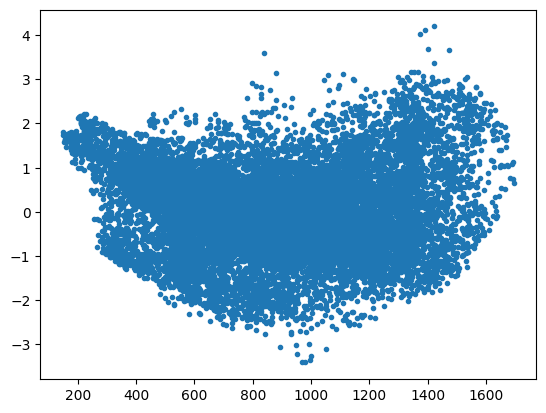

In [9]:
plt.plot( linear_fit.predict(features), linear_fit.resid_pearson, '.')

In [10]:
to_plot = pl.DataFrame({'gt': targets.squeeze(), 'pred':  linear_fit.predict(features)}
                      ).with_columns( (pl.col('gt') - pl.col('pred')).alias('error'))

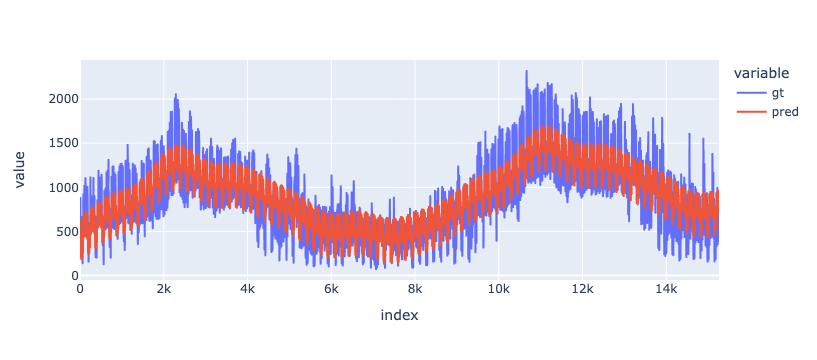

In [11]:
px.line(to_plot, y=['gt', 'pred'])

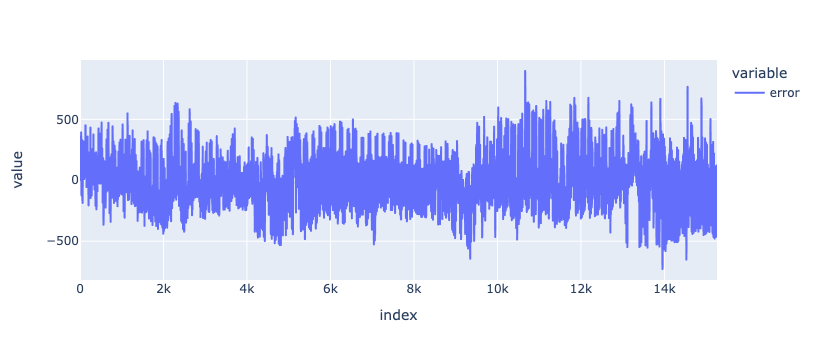

In [12]:
px.line(to_plot, y=['error'])

In this example, I see two features that seem to be throwing off the fits
1. The size of the peaks and valleys differs from summer to winter
2. There seems to be some 'jitter' in the locations of the peaks and valleys: in particular, toward the end of the fit.

Also, there appears to be a sizable periodic component remaining in the data.

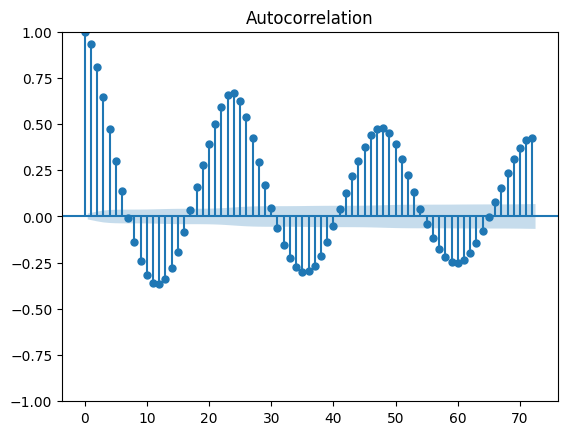

In [13]:
from statsmodels.graphics.tsaplots import plot_acf
_=plot_acf(to_plot['error'], lags=72)

Perhaps it is really as simple as including auto-correlations. I don't really know why I'm hesitant to do this. I guess it's because these features look periodic, so I want to fit them that way. This might be silly

There is also the issue of colinearity in the features that I have. Where is this coming from?

Ans: apparently from the daily trend interacting with the day features.

#### What does the daily variation around its mean look like?

From the plots, it looks the hour-to-hour variation is not the same between days: does it differ from normal?

In [14]:
sample_unit = train.filter(pl.col('prediction_unit_id') == 4)

sample_w_means = sample_unit.join(
                                sample_unit.group_by(pl.col('date_when_predicting')
                                          ).agg( daily_mean=pl.col( 'target').mean() ),
                                on='date_when_predicting'
                           ).with_columns( 
                                (pl.col('target') / pl.col('daily_mean')).alias('target_norm')
                           )


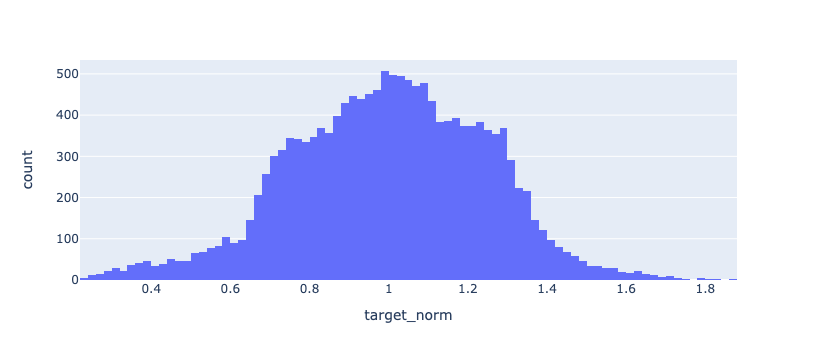

In [15]:
px.histogram(sample_w_means, x='target_norm')

This is lumpy, and has mixed slopes, but overall doesn't seem to terminally break the gaussianity assumption

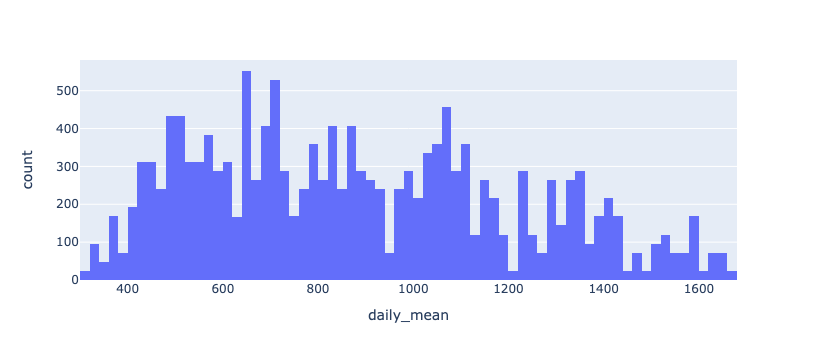

In [16]:
px.histogram(sample_w_means, x='daily_mean')

The day-to-day variation is certainly less nicely gaussian looking

#### What about winter vs summer day-to-day variation?

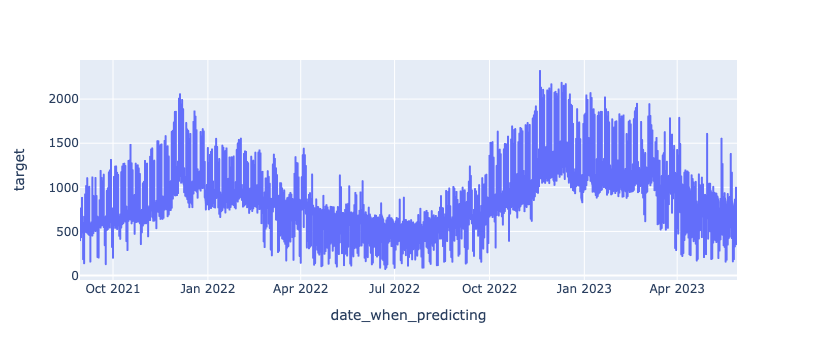

In [17]:
px.line( sample_w_means, x='date_when_predicting', y='target')

It's clear here (again) that day-to-day variation interacts with seasonal variation, with strong weekday spikes in winter, but less so in the summer.

What if we regress against that?

## Trying out different combinations of features

In [18]:
import statsmodels.formula.api as smf

In [19]:
# here, we use categorical time units as features
one_unit = full_data.filter( pl.col('prediction_unit_id') == 4
                   ).with_columns(
                        pl.col('prediction_datetime').dt.time().alias('time'),
                        pl.col('prediction_datetime').dt.weekday().alias('weekday'),
                        pl.col('prediction_datetime').dt.ordinal_day().alias('yearday'),
                        (pl.col('prediction_datetime').dt.date() - 
                             pd.to_datetime('2021-09-01').date()).dt.total_days().alias('trend')
                   )

### No interactions between features

In [20]:
independent_model = smf.ols('target ~ C(time) + C(weekday) + C(yearday) + trend', data=one_unit.to_pandas())
independent_model = independent_model.fit()

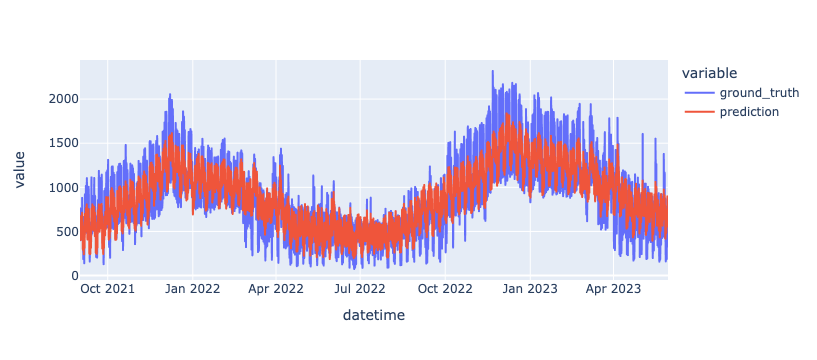

In [21]:
predictions = pl.DataFrame({'datetime': one_unit['prediction_datetime'],
                            'prediction': independent_model.predict(one_unit.to_pandas() ),
                            'ground_truth': one_unit['target']})
px.line( predictions, x='datetime', y=['ground_truth', 'prediction'])

### Weekday vs day of year interaction:

In [22]:
weekday_model = smf.ols('target ~ C(time) + C(weekday) * C(yearday) + trend', data=one_unit.to_pandas())
weekday_model = weekday_model.fit()

In [23]:
predictions = pl.DataFrame({'datetime': one_unit['prediction_datetime'],
                            'prediction': weekday_model.predict(one_unit.to_pandas() ),
                            'ground_truth': one_unit['target']})
px.line( predictions, x='datetime', y=['ground_truth', 'prediction'])

There might be slight improvement due to the additional interaction terms, but it does not capture the main missed features of the fit.

#### Alternative approach to mixed weekday-season features

To verify the results above.

In [24]:
# make different features for each day of the week.

def make_features_weekday(train):
    features = train[['prediction_datetime', 'row_id']]
    dates = features['prediction_datetime'].dt.date().unique()
    
    
    fourier = CalendarFourier(freq="A", order=6) 
    date_process = DeterministicProcess(
                            dates,
                            constant=False,
                            order=2,
                            seasonal=False,
                            additional_terms=[fourier],
                            drop=True
                          )

    # one set of features for each day.
    features_weekday = pl.DataFrame( dates )
    
    for i in range(1,8):
        current_dates = dates.filter(dates.dt.weekday() == i )
        current_features = pl.from_pandas( date_process.apply(current_dates).in_sample().reset_index() )
        features_weekday = features_weekday.join(current_features, left_on='prediction_datetime',
                              right_on=pl.col('index').dt.date(), how='left', suffix='_' + str(i))
    
    features_weekday = features_weekday.fill_null(0.).rename({'prediction_datetime':'date'})

    # time-dependent features
    features_times = features.with_columns( pl.col('prediction_datetime').dt.time().alias('time')
                  ).to_dummies('time')

    features = features_times.join(features_weekday, left_on=pl.col('prediction_datetime').dt.date(),
                         right_on='date'
                  ).drop('prediction_datetime')

    features, targets = align_features_targets(features, train[['row_id', 'target']])

    return features, targets

In [25]:
features, targets = make_features_weekday(sample_unit)

In [26]:
linear_model = sm.OLS(targets, features).fit()

In [27]:
to_plot = pl.DataFrame({'gt': targets.squeeze(), 'pred':  linear_model.predict(features)}
                      ).with_columns( (pl.col('gt') - pl.col('pred')).alias('error'))

In [28]:
px.line(to_plot, y=['gt', 'pred'])

Still very poor fits. Note that the fits _are_ different due to the use of calendar Fourier vs day of week encoding.

### Weekday vs time interactions

In [29]:
weekday_time_model = smf.ols('target ~ C(time) * C(weekday) + C(yearday) + trend', data=one_unit.to_pandas())
weekday_time_model = weekday_time_model.fit()

In [30]:
predictions = pl.DataFrame({'datetime': one_unit['prediction_datetime'],
                            'prediction': weekday_time_model.predict(one_unit.to_pandas() ),
                            'ground_truth': one_unit['target']})
px.line( predictions, x='datetime', y=['ground_truth', 'prediction'] )

Not there yet, but actually a significant better looking fit than the previous ones.

#### Conversely, fitting daily means with mixed weekday-season features

In [31]:
dates = train['prediction_datetime'].dt.date().unique()
features_weekday = pl.DataFrame( dates )

for i in range(1,8):
    current_dates = dates.filter(dates.dt.weekday() == i )
    current_features = pl.from_pandas( date_process.apply(current_dates).in_sample().reset_index() )
    features_weekday = features_weekday.join(current_features, left_on='prediction_datetime',
                          right_on=pl.col('index').dt.date(), how='left', suffix='_' + str(i))

features_weekday = features_weekday.fill_null(0.).rename({'prediction_datetime':'date'})


In [32]:
mean_production = sample_w_means[['prediction_datetime', 'daily_mean']
                                ].with_columns( pl.col('prediction_datetime').dt.date().alias('date')
                                ).unique()

In [33]:
aligned = mean_production.join( features_weekday, on='date')
targets = aligned['daily_mean'].to_pandas()
features = aligned.drop('prediction_datetime', 'daily_mean', 'date').to_pandas()

In [34]:
mean_model = sm.OLS(targets, features).fit()

to_plot = pl.DataFrame({'gt': targets.squeeze(), 'pred':  mean_model.predict(features)}
                      ).with_columns( (pl.col('gt') - pl.col('pred')).alias('error'))

In [35]:
px.line(to_plot, y=['gt', 'pred'])

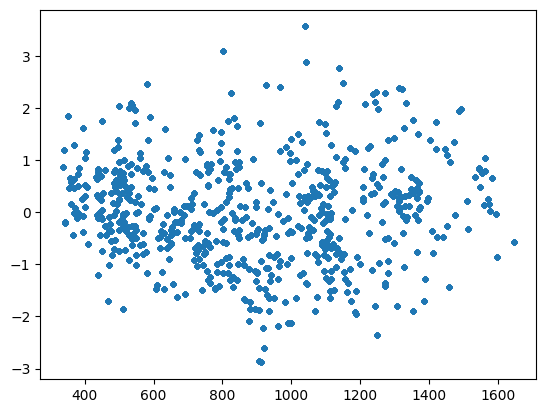

In [36]:
plt.plot(mean_model.predict(features), mean_model.resid_pearson, '.')

Here, we see that it is the hour-to-hour variations that are not well eplained by the simple models.

### Time vs day of year interactions

In [ ]:
yearday_time_model = smf.ols('target ~ C(weekday) + C(time) * C(yearday) + trend', data=one_unit.to_pandas())
yearday_time_model = yearday_time_model.fit()

In [ ]:
predictions = pl.DataFrame({'datetime': one_unit['prediction_datetime'],
                            'prediction': yearday_time_model.predict(one_unit.to_pandas() ),
                            'ground_truth': one_unit['target']})
px.line( predictions, x='datetime', y=['ground_truth', 'prediction'] )

Wow. This runs slow, but looks so much better. We need such interactions in out model.

8,760 parameters, and 15,260 points, so its pretty heavily parameterized.

We can address both speed and decrease the amount of parameters by using Fourier modes to model yearly trends.

In [ ]:
plt.plot(yearday_time_model.predict(one_unit.to_pandas()), yearday_time_model.resid_pearson, '.')

In [ ]:
px.line(
    predictions.with_columns((pl.col('ground_truth') - pl.col('prediction')
              ).alias('error') ),
    x='datetime', y='error' )

Here we definitely see over-fitting where there is only a single samples for each year-day, time combination.

### Coarser yearly features

In [ ]:
fourier = CalendarFourier(freq="A", order=6) 
fourier_modes = pl.from_pandas(
                        fourier.in_sample(one_unit['prediction_datetime'].dt.date().unique()
                              ).reset_index()
                  ).with_columns( pl.col('index').dt.date() )

In [ ]:
one_unit=one_unit.join(fourier_modes, left_on='date', right_on='index')

In [ ]:
one_unit = one_unit.rename(
    {col_name: f'{col_name[0:3]}_{col_name[4]}'  for col_name in one_unit.columns[-12:]}
)
fourier_columns = ' + '.join(one_unit.columns[-12:])

In [ ]:
fourier_time_model = smf.ols(f'target ~ C(weekday) * C(time) * ({fourier_columns} + trend)', data=one_unit.to_pandas())
fourier_time_model = fourier_time_model.fit()

In [ ]:
predictions = pl.DataFrame({'datetime': one_unit['prediction_datetime'],
                            'prediction': fourier_time_model.predict(one_unit.to_pandas() ),
                            'ground_truth': one_unit['target']}
                          ).with_columns( (pl.col('ground_truth') - pl.col('prediction')).alias('error'))
px.line( predictions, x='datetime', y=['ground_truth', 'prediction'])

In [ ]:
px.line(predictions, x='datetime', y='error')

In [ ]:
plt.plot(fourier_time_model.predict(one_unit.to_pandas()), fourier_time_model.resid_pearson, '.') 

In [ ]:
_=plot_acf(predictions['error'], lags=72)

This is not bad actually. There are still periods of large errors, and strong autocorrelation in the residuals, but it still looks like the fits are capturing the dominant periodic modes.

#### Some things that need validation:
1. The number of Fourier modes to use. (for some reason, more than 2 behaves very strangely)
2. The interaction basis between daily, weekly, and yearly factors
   - at the moment, I favor full interaction because it leads to autocorrelations that peak near 24 and 48 hours, which we know to probably be the case.

### Introducting autocorrelation

In [ ]:
import datetime
shifted_48 = one_unit[['target', 'prediction_datetime']
                 ].with_columns(pl.col('prediction_datetime') + datetime.timedelta(days=2) )
shifted_week = one_unit[['target', 'prediction_datetime']
                 ].with_columns(pl.col('prediction_datetime') + datetime.timedelta(days=7) )

with_autocorrelation = one_unit.join(shifted_48, on='prediction_datetime', suffix='_shifted_day')
with_autocorrelation = with_autocorrelation.join(shifted_week, on='prediction_datetime', suffix='_shifted_week')

In [ ]:
full_model = smf.ols(f'target ~ C(weekday) * C(time) * ({fourier_columns} + trend) + C(weekday)*target_shifted_day + target_shifted_week',
                     data=with_autocorrelation.to_pandas())
full_model = full_model.fit()

In [ ]:
predictions = pl.DataFrame({'datetime': with_autocorrelation['prediction_datetime'],
                            'prediction': full_model.predict(with_autocorrelation.to_pandas() ),
                            'ground_truth': with_autocorrelation['target']}
                          ).with_columns( (pl.col('ground_truth') - pl.col('prediction')).alias('error'))
px.line( predictions, x='datetime', y=['ground_truth', 'prediction'])

In [ ]:
px.line(predictions, x='datetime', y='error')

In [ ]:
plt.plot(full_model.predict(with_autocorrelation.to_pandas()), full_model.resid_pearson, '.') 

In [ ]:
_=plot_acf(predictions['error'], lags=72)

Autocorrelations do indeed seem helpful.

#### I think that this is a good set of features to get started with.